# In the name of God
# Machine Learning for Bioinformatics (Spring 1400)
# HW4 - CNN

# Student Info

## Full Name: (AmirHossein Mohammadi)

## Student Number: (99201081)

## Don't forget to change this file name to HW4_{student number}.ipynb


In [1]:
########################## P0 ##########################
# README                                               #
########################################################
# You must fill the parts like this that surrounded by comments
########################## END #########################

# Imports

In [2]:
RUN_LOCAL = False  # if you want to run this on colab, set this to False

In [2]:
# https://github.com/jacobgil/pytorch-grad-cam
if not RUN_LOCAL:
    !pip install grad-cam

In [3]:
!pip install ttach

In [3]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms 
from torch.utils.data import DataLoader
from tqdm.auto import tqdm
if not RUN_LOCAL:
    from google.colab import drive
from IPython import display
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from pytorch_grad_cam import GradCAMPlusPlus
from pytorch_grad_cam.utils.image import show_cam_on_image,preprocess_image

# Configs

In [4]:
%matplotlib inline

In [5]:
BATCH_SIZE = 32
DATA_LOADER_KWARGS = {
    'batch_size': BATCH_SIZE, 
    'shuffle': True,
    'pin_memory': True,
    'num_workers': 0,
}

RGB_MEANS = [0.485, 0.456, 0.406]
RGB_STD = [0.229, 0.224, 0.225]

In [6]:
DEVICE =None
########################## P1 ##########################
# check if gpu is available then put DEVICE to cuda:0  #
# else DEVICE is equal to cpu.                         #
########################################################
if torch.cuda.is_available():
     DEVICE=cuda0 = torch.device('cuda:0')
else:
    DEVICE=cuda0 = torch.device('cpu')
########################## END #########################
DEVICE

device(type='cuda', index=0)

# Data

## Load from Google Drive (if you want to run code on colab)

First create a folder named "ML for Bio - Spring 1400" in your google drive root and copy the content of [this link](https://drive.google.com/drive/folders/1X53xvmmS3avr6py7Cf1LUq8DSA1EvNpC?usp=sharing) to it.

Make sure you do this correctly and the next cell runs with no error.

In [7]:
if not RUN_LOCAL:
    # Load data from google drive
    drive.mount('/content/drive', force_remount=True)

    # Don't change this, you must put the data here in your Google Drive
    FOLDERNAME = 'ML\ for\ Bio\ -\ Spring\ 1400/brain-tumor-dataset'

    %cd drive/My\ Drive
    %cp -r $FOLDERNAME ../../
    %cd ../../brain-tumor-dataset
    !unzip -q dataset.zip
    !rm dataset.zip
    %cd ..

Mounted at /content/drive
/content/drive/My Drive
/content/brain-tumor-dataset
replace no/no0.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: َ
error:  invalid response [َ]
replace no/no0.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
/content


## Local Data

If you want to run the code locally, download the [dataset.zip](https://drive.google.com/file/d/158VyFbTPLHE_uN2yXvMtalSqdD2mdd5r/view?usp=sharing) and extract it in 'brain-tumor-dataset' folder besides your code. it must has a structure like below:

```
HW4_{student number}.ipynb
brain-tumor-dataset/
    no/
    yes/
```

## Create DataLoaders

In [8]:
transforms = []
########################## P2 ##########################
# Create a list of torchvision.transforms to:          #
# 1- Resize the image to 256x265 pixels                #
# 2- Center Crop the image to 224x224 pixels           #
# 3- Convert To Tensor                                 #
# 4- Normalize the tensor with RGB_MEANS and RGB_STD   #
########################################################
transforms.append(torchvision.transforms.Resize(256))
transforms.append(torchvision.transforms.CenterCrop(224))
transforms.append(torchvision.transforms.ToTensor())
transforms.append(torchvision.transforms.Normalize(
       mean=RGB_MEANS,
       std=RGB_STD))
########################## END #########################
transforms = torchvision.transforms.Compose(transforms)

transforms

Compose(
    Resize(size=256, interpolation=bilinear, max_size=None, antialias=None)
    CenterCrop(size=(224, 224))
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)

In [9]:
train_dataset, val_dataset, test_dataset = None, None, None
all_dataset = torchvision.datasets.ImageFolder('brain-tumor-dataset', transform=transforms)
########################## P3 ##########################
# First split the all_dataset into three datasets with:#
# 70% Train, 20% Validation, 10% Test.                 #
# There is a function in torch.utils for this purpose. #
########################################################
train_dataset, val_dataset = torch.utils.data.random_split(all_dataset,[2100, 900])
val_dataset, test_dataset = torch.utils.data.random_split(val_dataset, [600, 300])
########################## END #########################
train_loader = DataLoader(train_dataset, **DATA_LOADER_KWARGS)
val_loader = DataLoader(val_dataset, **DATA_LOADER_KWARGS)
test_loader = DataLoader(test_dataset, **DATA_LOADER_KWARGS)

print('Train Classes Dist:', np.bincount(np.array(all_dataset.targets)[train_dataset.indices]))
print('Val Classes Dist:  ', np.bincount(np.array(all_dataset.targets)[val_dataset.indices]))
print('Test Classes Dist: ', np.bincount(np.array(all_dataset.targets)[test_dataset.indices]))


Train Classes Dist: [1044 1056]
Val Classes Dist:   [600]
Test Classes Dist:  [300]


In [10]:
input_shape = tuple(all_dataset[0][0].shape)
num_classes = len(all_dataset.classes)

print('Input Shape =', input_shape)
print('Num of Classes =', num_classes)

Input Shape = (3, 224, 224)
Num of Classes = 2


## Visualizing

In [11]:
class UnNormalize(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std

    def __call__(self, tensor):
        """
        Args:
            tensor (Tensor): Tensor normalized image of size (C, H, W).
        Returns:
            Tensor: UnNormalized image.
        """
        for t, m, s in zip(tensor, self.mean, self.std):
            t.mul_(s).add_(m)
        return tensor

unnormalize = UnNormalize(RGB_MEANS, RGB_STD)

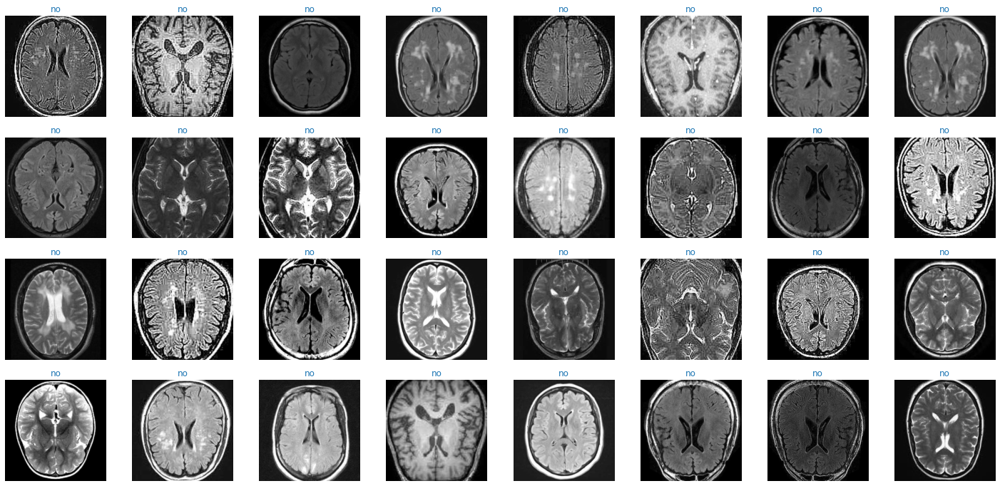

In [12]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(test_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)

fig = plt.figure(figsize=(25, 12))
gs = fig.add_gridspec(int(np.ceil(vis_num_images / vis_images_per_row)), vis_images_per_row)

for i in range(vis_num_images):
    ax = fig.add_subplot(gs[i // vis_images_per_row, i % vis_images_per_row])
    ax.set_title(f'{all_dataset.classes[vis_labels[i]]}', c=f'C{vis_labels[i]}')
    ax.axis('off')
    ax.imshow(vis_images[i])

plt.show()

# Train & Test Methods

## Train

In [13]:
def train(model, train_loader, val_loader, optimizer, num_epochs=10):
    train_log = []
    test_log = []
    plt.figure(figsize=(16, 8))

    for epoch in range(1, num_epochs+1):
        train_loss = []
        model.train()
        for inputs, targets in tqdm(train_loader, desc='Training epoch ' + str(epoch), leave=False):        
            inputs, targets = inputs.to(DEVICE), targets.to(DEVICE)        
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = model.get_loss(outputs, targets)
            loss.backward()
            optimizer.step()
            train_loss.append(loss.item())
        train_log.append(np.mean(train_loss))

        test_loss = []
        model.eval()
        with torch.no_grad():                
            for inputs, targets in tqdm(test_loader, desc='Validation', leave=False):         
                inputs, targets = inputs.to(DEVICE), targets.to(DEVICE)
                outputs = model(inputs)
                loss = model.get_loss(outputs, targets)
                test_loss.append(loss.item())
        test_log.append(np.mean(test_loss))

        plt.clf()
        plt.title(f'Epoch {epoch}/{num_epochs}')
        plt.plot(range(1, epoch+1), train_log, color='C0', label='Train')
        plt.plot(range(1, epoch+1), test_log, color='C1', label='Val')
        plt.legend()
        display.clear_output(wait=True)
        display.display(plt.gcf())

    plt.close()

## Test

In [14]:
def test(model, data_loader):
    y_true, y_pred = [], []

    with torch.no_grad():                
        for inputs, targets in tqdm(data_loader, desc='Predicting', leave=False):         
            inputs, targets = inputs.to(DEVICE), targets.to(DEVICE)
            outputs = model(inputs)
            if type(outputs) is tuple: outputs = outputs[-1]
            outputs = outputs.detach().cpu().numpy()

            y_true += targets.detach().cpu().numpy().tolist()
            y_pred += np.argmax(outputs, axis=-1).tolist()

    print(classification_report(y_true, y_pred, target_names=all_dataset.classes))

# Model Definition

In [15]:
  class ConvClassifier(nn.Module):
    def __init__(self, input_shape, num_classes, convs, fcs, conv_drop_rate=None, fc_drop_rate=None):
        """
        Args:
            input_shape: the dimension of the input image.
            num_classes: number of output classes.
            convs: it's 'vgg16' or a list of tuples with these info\:
                (out_channels, kernel_size, stride, padding, has_pooling), the first four are
                the configuration for creating a Conv2d layer and if has_pooling was True, you
                must add a MaxPool2d after the Conv2d.
            fcs: a list of integers representing number of Linear neurons in each layer
            conv_drop_rate: float(0-1), drop rate used for Conv2d layers
            fc_drop_rate: float(0-1), drop rate used for Linear layers
        """
        super(ConvClassifier, self).__init__()

        # Convolution Layers
        self.conv_layers = None
        if convs == 'vgg16':
            vgg16_pretrained = None
            ########################## P4 ##########################
            # set `vgg16_pretrained` to pretrained vgg16 model with#
            # batch normalization                                  #
            ########################################################
            vgg16_pretrained = torchvision.models.vgg16_bn() 
            vgg16_pretrained.load_state_dict(torch.hub.load_state_dict_from_url('https://download.pytorch.org/models/vgg16_bn-6c64b313.pth'))
            ########################## END #########################
            self.conv_layers = vgg16_pretrained.features
        elif type(convs) is list:
            conv_layers = []
            vgg16_pretrained = torchvision.models.vgg16_bn() 
            ########################## P5 ##########################
            # for each item in `convs` add these 3-5 items to      #
            # `conv_layers`:                                       #
            # 1- nn.Conv2d                                         #
            # 2- nn.BatchNorm2d                                    #
            # 3- nn.ReLU                                           #
            # 4- nn.Dropout if `conv_drop_rate` is not None        #
            # 5- nn.MaxPool2d(2, 2) if has_pooling is True         #
            ########################################################
            conv_layers.append(nn.Conv2d(3, convs[0][0],kernel_size=convs[0][1], stride=convs[0][2], padding=convs[0][3]))
            conv_layers.append(nn.BatchNorm2d(convs[0][0]))
            conv_layers.append(nn.ReLU(inplace=True))
            if conv_drop_rate!=None:
                conv_layers.append(nn.Dropout(conv_drop_rate))
            if convs[0][4]==True:
                conv_layers.append(nn.MaxPool2d(2, 2))
            for i in range(1,len(convs)):
                conv_layers.append(nn.Conv2d(convs[i-1][0], convs[i][0],kernel_size=convs[i][1], stride=convs[i][2], padding=convs[i][3]))
                conv_layers.append(nn.BatchNorm2d(convs[i][0]))
                conv_layers.append(nn.ReLU())
                if conv_drop_rate!=None:
                    conv_layers.append(nn.Dropout(conv_drop_rate))
                if convs[i][4]==True:
                    conv_layers.append(nn.MaxPool2d(2, 2))
                
            ########################## END #########################
            self.conv_layers = nn.Sequential(*conv_layers)
        else:
            raise Exception(f'Wrong value for parameter `convs`: {convs}')
        # Get the output shape of last conv layer
        convs_output_shape = self.conv_layers(torch.randn(1, *input_shape)).shape[1:]

        # Fully Connected Layers
        fc_layers = []
        ########################## P6 ##########################
        # first add a nn.Flatten to `fc_layers` then for each  #
        # value in `fcs` add these 3-4 items to `fc_layers`:   #
        # 1- nn.Linear                                         #
        # 2- nn.BatchNorm1d                                    #
        # 3- nn.ReLU                                           #
        # 4- nn.Dropout if `fc_drop_rate` is not None          #
        # in the end add a nn.Linear for the final output with #
        # `num_classes` neurons and a nn.Softmax after it.     #
        ########################################################
        fc_layers.append(nn.Flatten())
        fc_layers.append(nn.Linear(convs_output_shape[0]*convs_output_shape[1]*convs_output_shape[2],fcs[0]))
        fc_layers.append(nn.BatchNorm1d(fcs[0]))
        fc_layers.append(nn.ReLU())
        if fc_drop_rate!=None:
            fc_layers.append(nn.Dropout(fc_drop_rate))
        for i in range(1,len(fcs)):
            fc_layers.append(nn.Linear(fcs[i-1],fcs[i]))
            fc_layers.append(nn.BatchNorm1d(fcs[i]))
            fc_layers.append(nn.ReLU())
            if fc_drop_rate!=None:
                fc_layers.append(nn.Dropout(fc_drop_rate))
        fc_layers.append(nn.Linear(fcs[len(fcs)-1],num_classes))  
        fc_layers.append(nn.Softmax())
        ########################## END #########################
        self.fc_layers = nn.Sequential(*fc_layers)
        self.cross_entropy = nn.CrossEntropyLoss()

    def forward(self, x):
        output = None
        ########################## P7 ##########################
        # generate the output using created variables.         #
        ########################################################
        output1=self.conv_layers(x)
        output=self.fc_layers(output1)
        
        ########################## END #########################
        return output

    def get_loss(self, outputs, targets):
        loss = None
        ########################## P8 ##########################
        # calculate the loss using `self.cross_entropy`        #
        ########################################################
        loss=self.cross_entropy(outputs,targets)
        ########################## END #########################
        return loss

# Vanilla VGG16 (no pretrain)

## Create Model

In [19]:
vgg16 = None
convs=[(64,3,1,1,False),(64,3,1,1,True),(128,3,1,1,False),
  (128,3,1,1,True),(256,3,1,1,False),(256,3,1,1,False),(256,3,1,1,True),
  (512,3,1,1,False),
  (512,3,1,1,False),(512,3,1,1,True),(512,3,1,1,False),
  (512,3,1,1,False),(512,3,1,1,True)]
fcs=[4096,4096,1000]

########################## P9 ##########################
# By using the `ConvClassifier` class create vgg16.    #
# in this part you must write the layers specifications#
# yourself (use convs = list of tuples).               #
# Change the drop rates to get best result in 10 epochs#
########################################################
vgg16=ConvClassifier(input_shape=input_shape,num_classes=num_classes,convs=convs,fcs=fcs,conv_drop_rate=0.1,fc_drop_rate=0.1)
########################## END #########################

vgg16.to(DEVICE)
vgg16

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


ConvClassifier(
  (conv_layers): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Dropout(p=0.1, inplace=False)
    (4): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): Dropout(p=0.1, inplace=False)
    (8): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): Dropout(p=0.1, inplace=False)
    (13): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (14): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (15): ReLU()
    (16): Dr

## Train

In [20]:
optimizer = torch.optim.Adam(vgg16.parameters(), lr=1e-3)

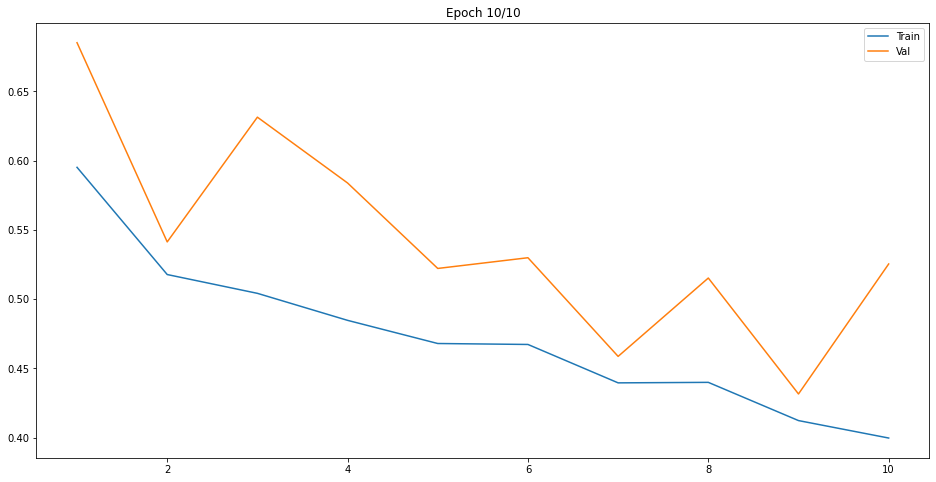

In [21]:
train(vgg16, train_loader, val_loader, optimizer, num_epochs=10)

## Test

In [22]:
test(vgg16, train_loader)

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.95      0.56      0.70      1039
         yes       0.69      0.97      0.81      1061

    accuracy                           0.77      2100
   macro avg       0.82      0.76      0.76      2100
weighted avg       0.82      0.77      0.76      2100



In [23]:
test(vgg16, val_loader)

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.94      0.48      0.64       314
         yes       0.63      0.97      0.76       286

    accuracy                           0.71       600
   macro avg       0.78      0.72      0.70       600
weighted avg       0.79      0.71      0.70       600



In [24]:
test(vgg16, test_loader)

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.91      0.58      0.71       147
         yes       0.70      0.95      0.81       153

    accuracy                           0.77       300
   macro avg       0.81      0.76      0.76       300
weighted avg       0.81      0.77      0.76       300



## CAM (Class Activation Map)

In [16]:
def CAM(model, target_layer):
    fig = plt.figure(figsize=(25, 12))
    gs = fig.add_gridspec(int(np.ceil(vis_num_images / vis_images_per_row)), vis_images_per_row)
    ########################## P10 #########################
    # Create the same grid of images as "Visualizing" part #
    # but you must add G_CAM overlay to them too. use        #
    # `GradG_CAMPlusPlus` and `show_G_CAM_on_image` for this.  #
    ########################################################
    for i in range(vis_num_images):
        ax = fig.add_subplot(gs[i // vis_images_per_row, i % vis_images_per_row])
        ax.set_title(f'{all_dataset.classes[vis_labels[i]]}', c=f'C{vis_labels[i]}')
        ax.axis('off')
        ax.imshow(vis_images[i])
    ###################################################################
    fig1 = plt.figure(figsize=(25, 12))
    gs_CA = fig.add_gridspec(int(np.ceil(vis_num_images / vis_images_per_row)), vis_images_per_row)
    for i in range(vis_num_images):
        ax = fig1.add_subplot(gs_CA[i // vis_images_per_row, i % vis_images_per_row])
        ax.set_title(f'{all_dataset.classes[vis_labels[i]]}', c=f'C{vis_labels[i]}')
        ax.axis('off')
        G_CAM = GradCAMPlusPlus(model=model, target_layer=target_layer)
        back_G_CAM = G_CAM(input_tensor=preprocess_image(vis_images[i],mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]).to(DEVICE))
        back_G_CAM = back_G_CAM[0, :]
        output = show_cam_on_image(vis_images[i],mask=back_G_CAM)
        ax.imshow(output)
    
    
    

    plt.show()

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


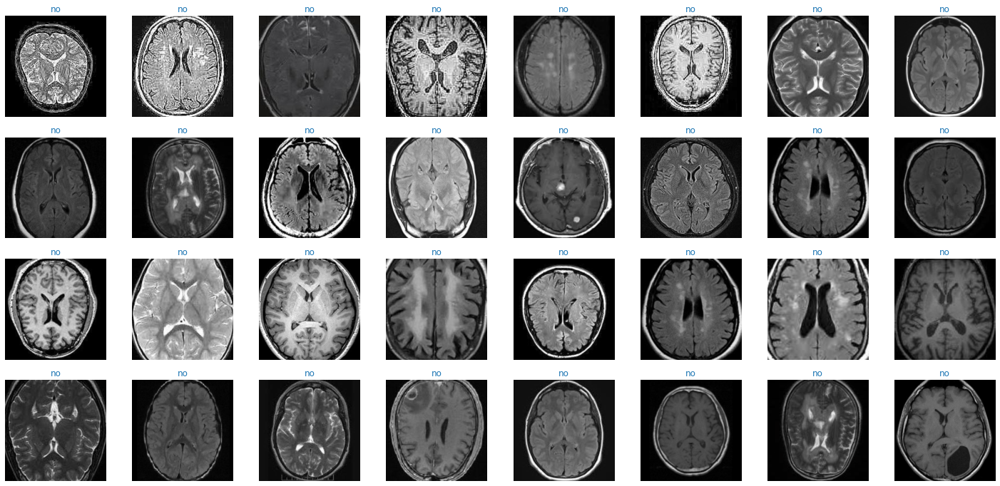

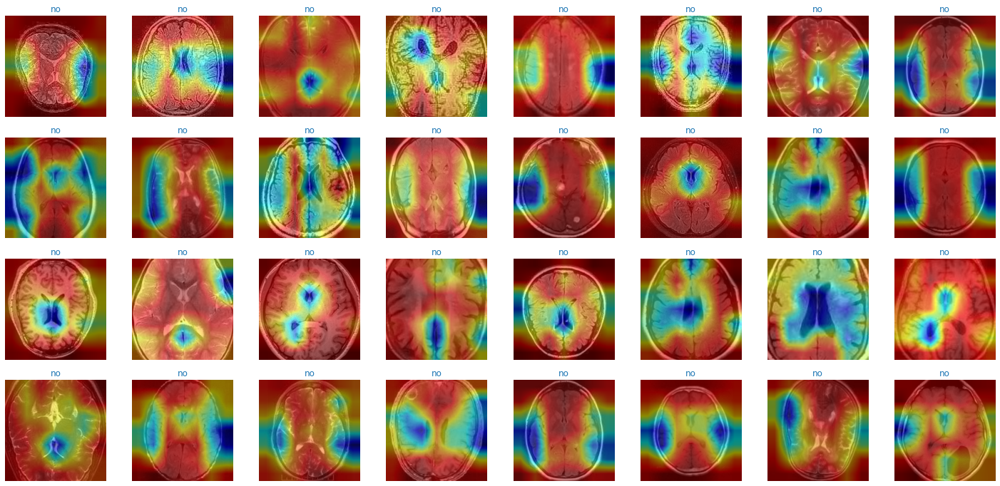

In [26]:
CAM(vgg16, vgg16.conv_layers[-1])

In [27]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(train_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)


/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


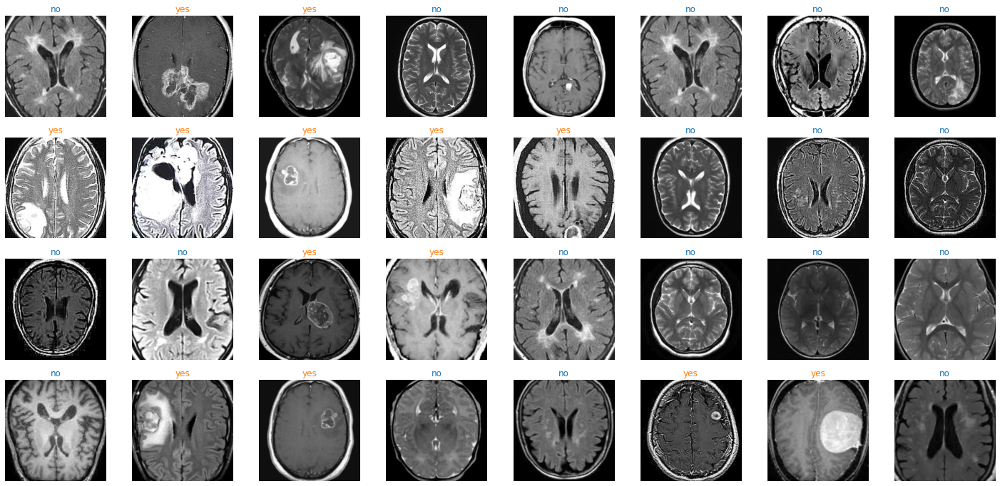

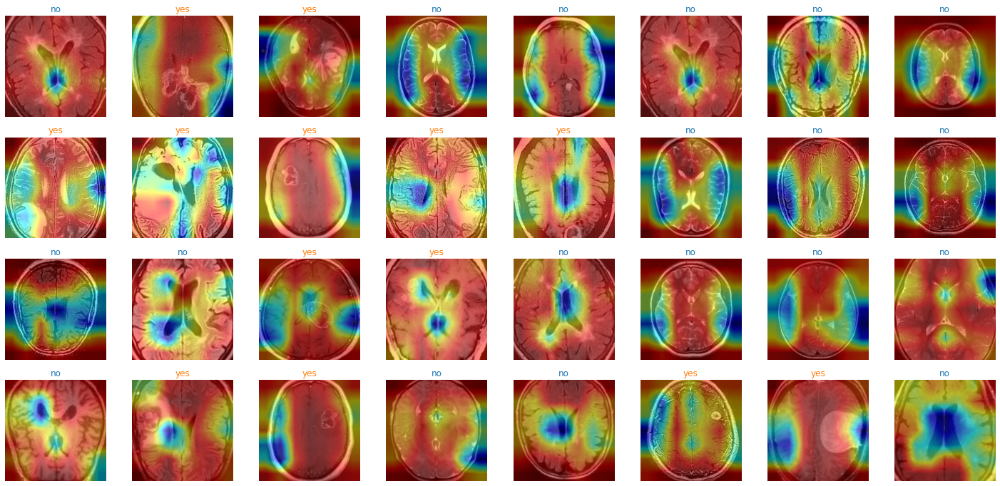

In [28]:
CAM(vgg16, vgg16.conv_layers[-1])

# Transfer Learning

## Create Model

In [17]:
vgg16_imagenet = None
########################## P11 #########################
# Like "P9" but use convs = 'vgg16' this time.           #
########################################################
########################## END #########################
convs='vgg16'
fcs=[4096,4096,1000]
########################################################
vgg16_imagenet=ConvClassifier(input_shape=input_shape,num_classes=num_classes,convs=convs,fcs=fcs,conv_drop_rate=0.1,fc_drop_rate=0.5)
########################## END #########################

vgg16_imagenet.to(DEVICE)
vgg16_imagenet

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


ConvClassifier(
  (conv_layers): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): C

## Train

In [19]:
########################## P12 #########################
# Change the Learning Rate and compare the results.    #
# write your observation and its reasons in the next   #
# cell.                                                #
########################################################
optimizer = torch.optim.Adam(vgg16_imagenet.parameters(), lr=1e-3)
########################## END #########################

P12 Answer:


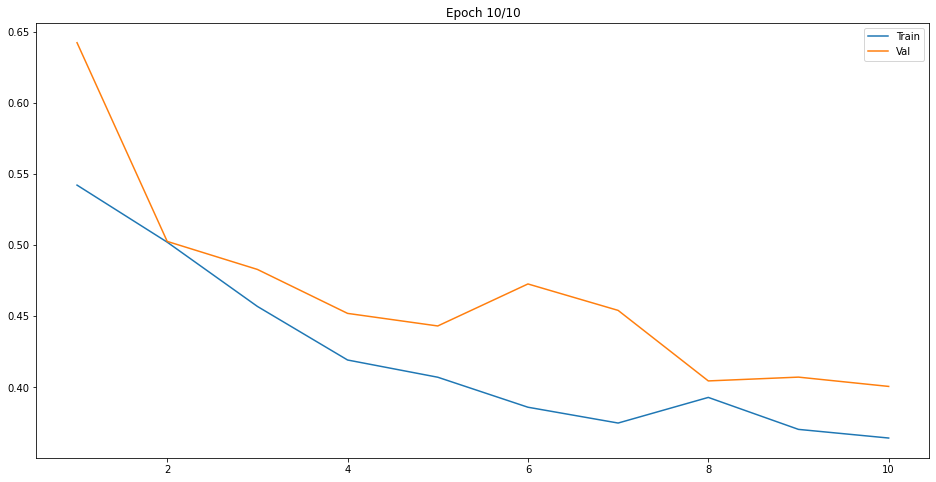

In [20]:
train(vgg16_imagenet, train_loader, val_loader, optimizer, num_epochs=10)

## Test

In [22]:
test(vgg16_imagenet, train_loader)

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.97      0.95      0.96      1044
         yes       0.95      0.98      0.96      1056

    accuracy                           0.96      2100
   macro avg       0.96      0.96      0.96      2100
weighted avg       0.96      0.96      0.96      2100



In [23]:
test(vgg16_imagenet, val_loader)

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.96      0.94      0.95       309
         yes       0.94      0.96      0.95       291

    accuracy                           0.95       600
   macro avg       0.95      0.95      0.95       600
weighted avg       0.95      0.95      0.95       600



In [24]:
test(vgg16_imagenet, test_loader)

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.92      0.90      0.91       147
         yes       0.90      0.93      0.92       153

    accuracy                           0.91       300
   macro avg       0.91      0.91      0.91       300
weighted avg       0.91      0.91      0.91       300



## CAM (Class Activation Map)

In [25]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(test_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)


/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


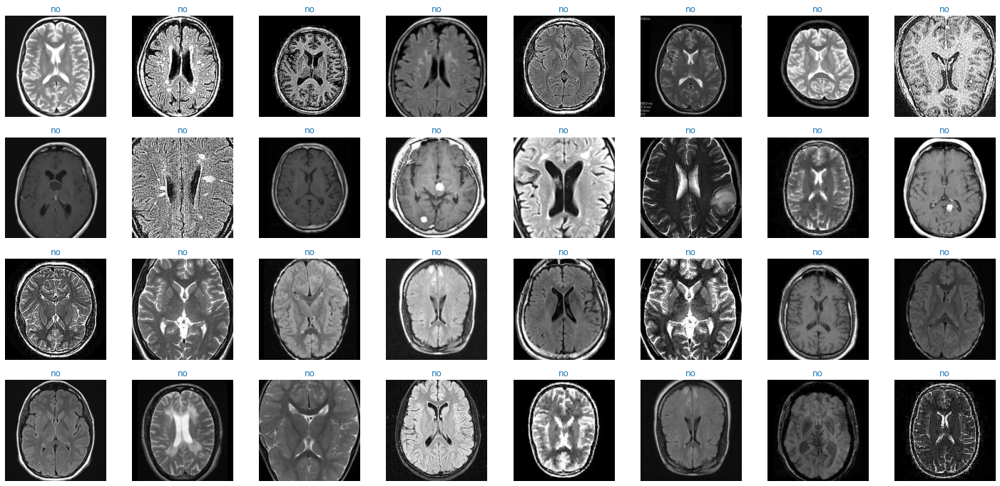

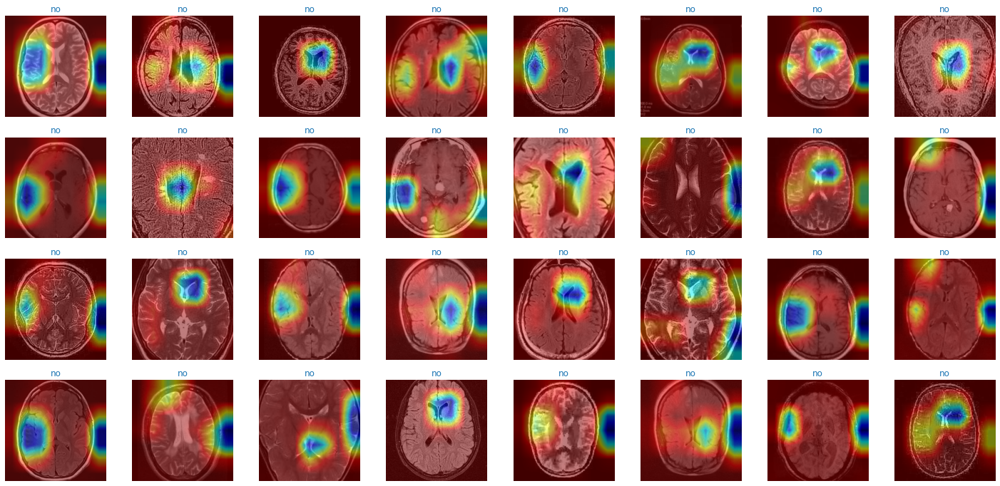

In [28]:
CAM(vgg16_imagenet, vgg16_imagenet.conv_layers[-1])

In [29]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(train_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)


/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


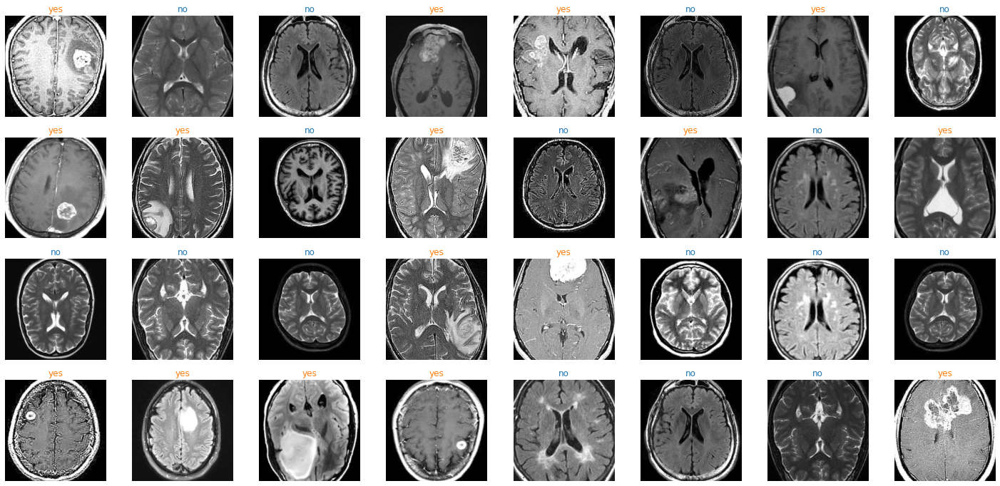

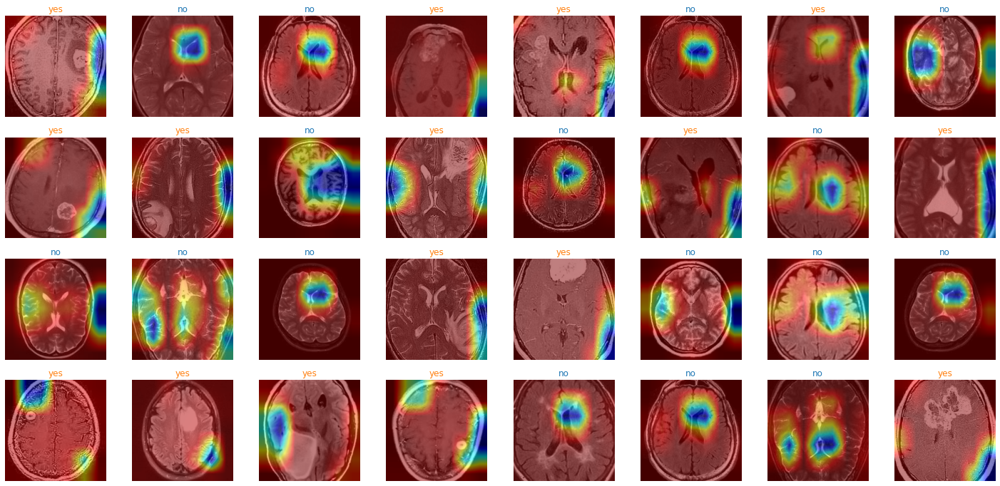

In [30]:
CAM(vgg16_imagenet, vgg16_imagenet.conv_layers[-1])

In [21]:
########################## P12 #########################
# Change the Learning Rate and compare the results.    #
# write your observation and its reasons in the next   #
# cell.                                                #
########################################################
optimizer = torch.optim.Adam(vgg16_imagenet.parameters(), lr=1e-2)
########################## END #########################

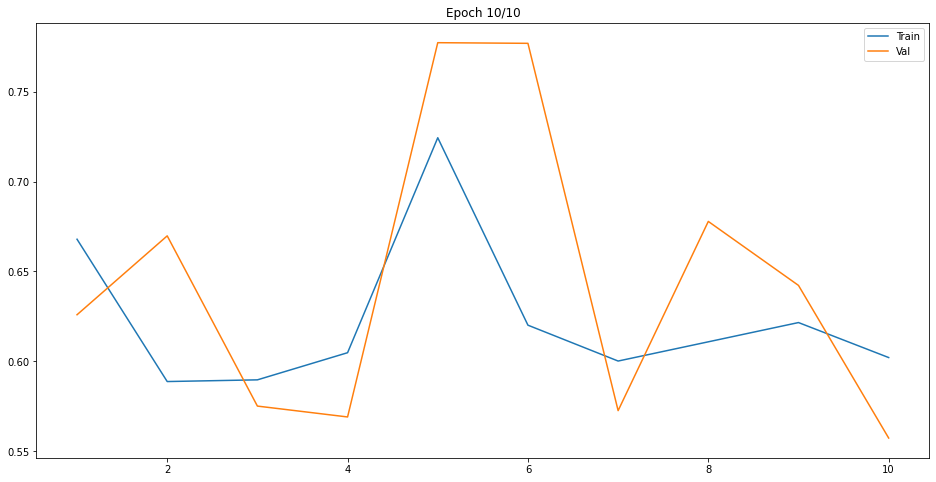

In [22]:
train(vgg16_imagenet, train_loader, val_loader, optimizer, num_epochs=10)

In [23]:
test(vgg16_imagenet, train_loader)

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.78      0.65      0.71      1060
         yes       0.70      0.81      0.75      1040

    accuracy                           0.73      2100
   macro avg       0.74      0.73      0.73      2100
weighted avg       0.74      0.73      0.73      2100



In [24]:
test(vgg16_imagenet, val_loader)

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.74      0.65      0.69       300
         yes       0.69      0.78      0.73       300

    accuracy                           0.71       600
   macro avg       0.72      0.71      0.71       600
weighted avg       0.72      0.71      0.71       600



In [25]:
test(vgg16_imagenet, test_loader)

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.74      0.74      0.74       140
         yes       0.78      0.78      0.78       160

    accuracy                           0.76       300
   macro avg       0.76      0.76      0.76       300
weighted avg       0.76      0.76      0.76       300



In [26]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(test_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)


/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)
/usr/local/lib/python3.7/dist-packages/pytorch_grad_cam/base_cam.py:85: RuntimeWarning: invalid value encountered in true_divide
  img = img / np.max(img)


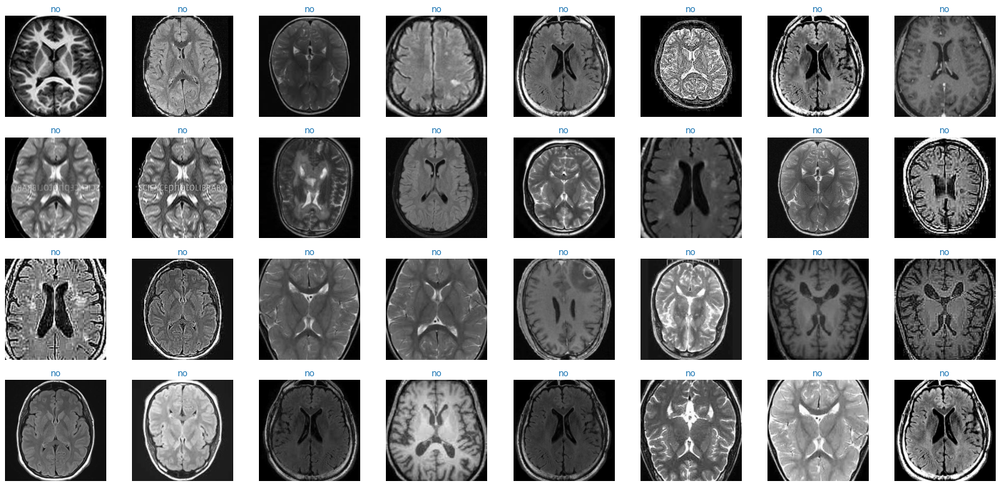

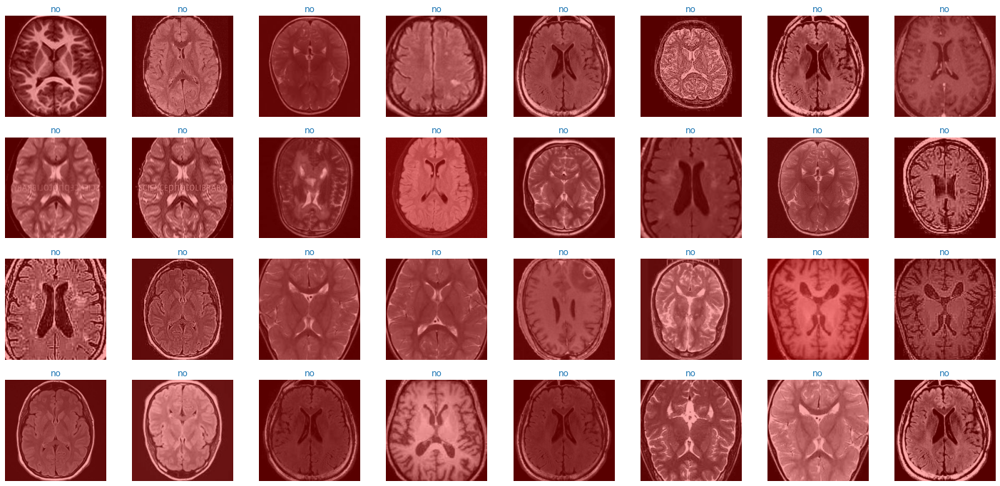

In [27]:
CAM(vgg16_imagenet, vgg16_imagenet.conv_layers[-1])

In [28]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(train_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)


/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)
/usr/local/lib/python3.7/dist-packages/pytorch_grad_cam/base_cam.py:85: RuntimeWarning: invalid value encountered in true_divide
  img = img / np.max(img)


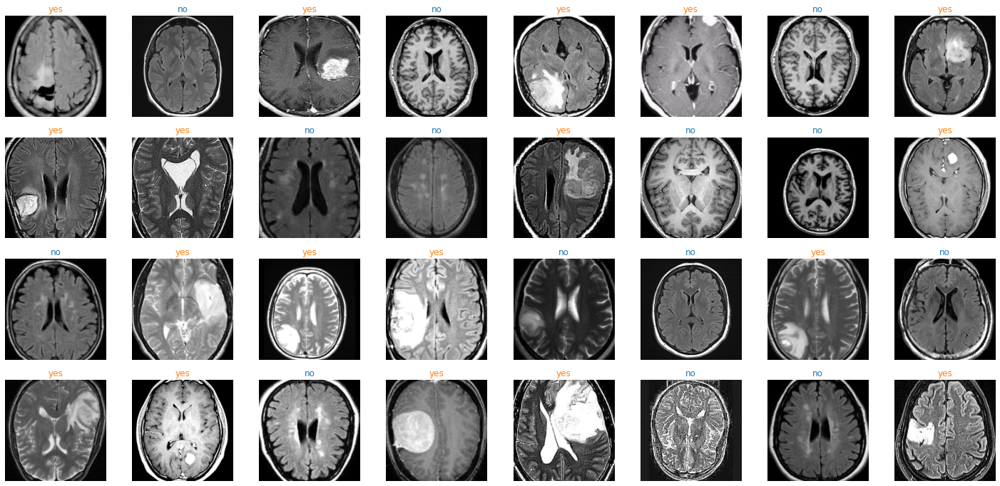

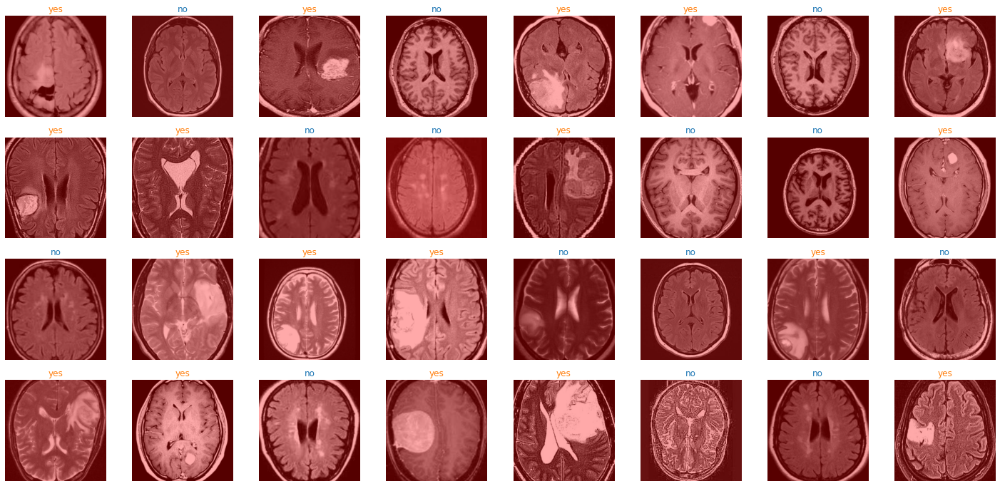

In [29]:
CAM(vgg16_imagenet, vgg16_imagenet.conv_layers[-1])

In [18]:
########################## P12 #########################
# Change the Learning Rate and compare the results.    #
# write your observation and its reasons in the next   #
# cell.                                                #
########################################################
optimizer = torch.optim.Adam(vgg16_imagenet.parameters(), lr=1e-4)
########################## END #########################

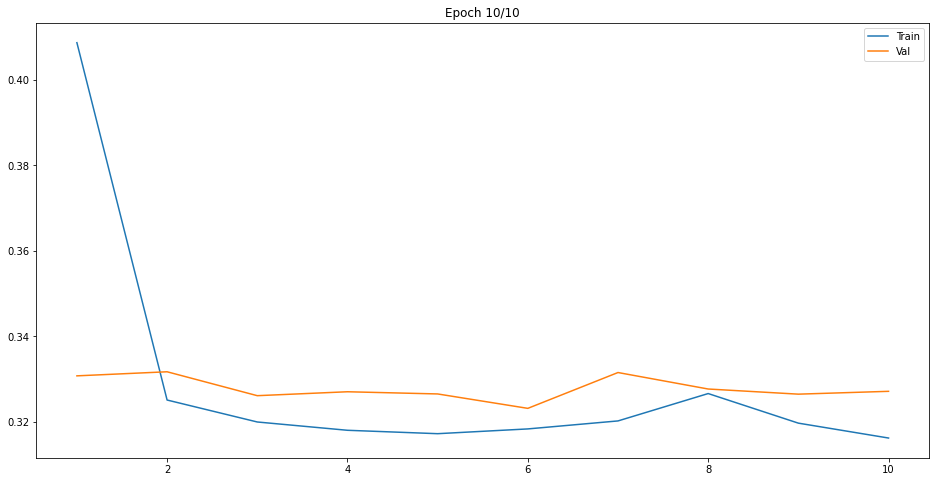

In [19]:
train(vgg16_imagenet, train_loader, val_loader, optimizer, num_epochs=10)

In [20]:
test(vgg16_imagenet, train_loader)

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       1.00      1.00      1.00      1044
         yes       1.00      1.00      1.00      1056

    accuracy                           1.00      2100
   macro avg       1.00      1.00      1.00      2100
weighted avg       1.00      1.00      1.00      2100



In [21]:
test(vgg16_imagenet, val_loader)

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.99      0.99      0.99       305
         yes       0.99      0.99      0.99       295

    accuracy                           0.99       600
   macro avg       0.99      0.99      0.99       600
weighted avg       0.99      0.99      0.99       600



In [22]:
test(vgg16_imagenet, test_loader)

/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


              precision    recall  f1-score   support

          no       0.97      0.99      0.98       151
         yes       0.99      0.97      0.98       149

    accuracy                           0.98       300
   macro avg       0.98      0.98      0.98       300
weighted avg       0.98      0.98      0.98       300



/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


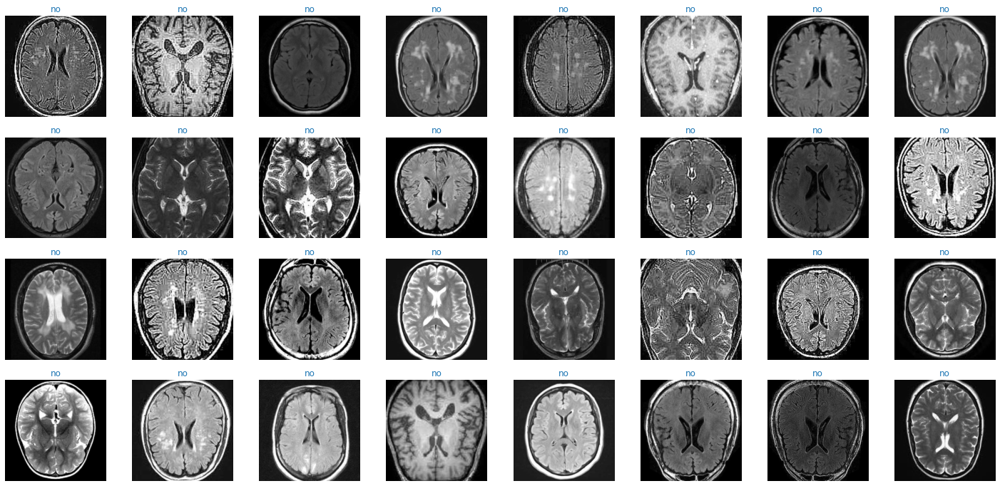

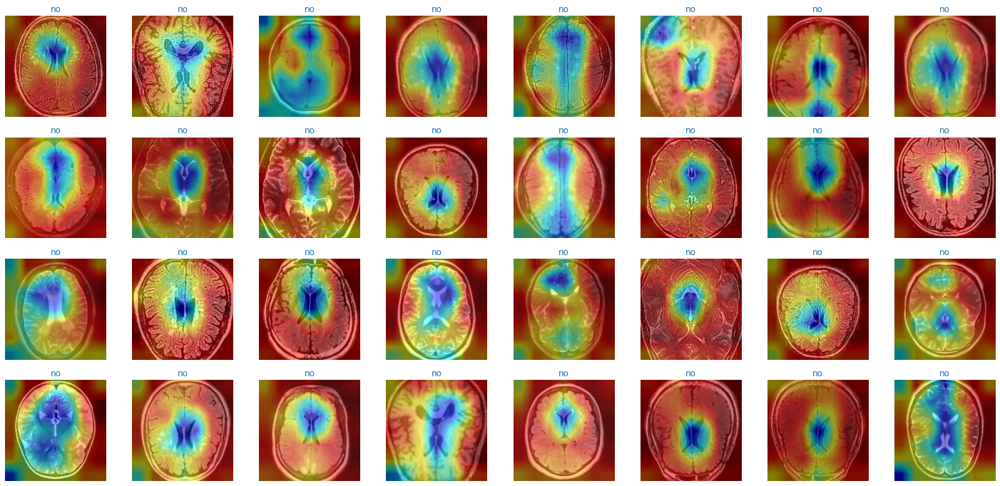

In [23]:
CAM(vgg16_imagenet, vgg16_imagenet.conv_layers[-1])

In [24]:
vis_num_images = 32
vis_images_per_row = 8

np.random.seed()
vis_image_indexes = np.random.choice(train_dataset.indices, size=vis_num_images, replace=False)
vis_images, vis_labels = [], []
for i in vis_image_indexes:
    new_image, new_label = all_dataset[i]
    vis_images.append(np.moveaxis(unnormalize(new_image).numpy(), 0, -1))
    vis_labels.append(new_label)


/usr/local/lib/python3.7/dist-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


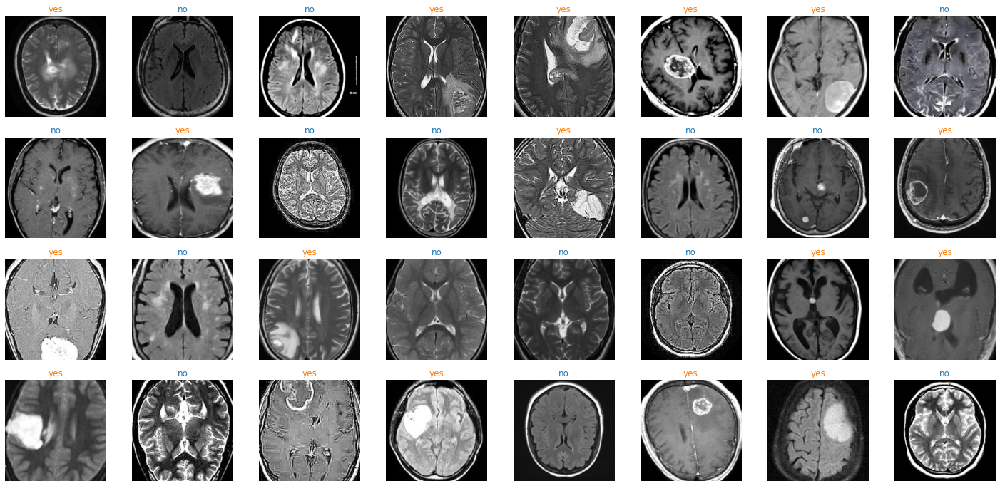

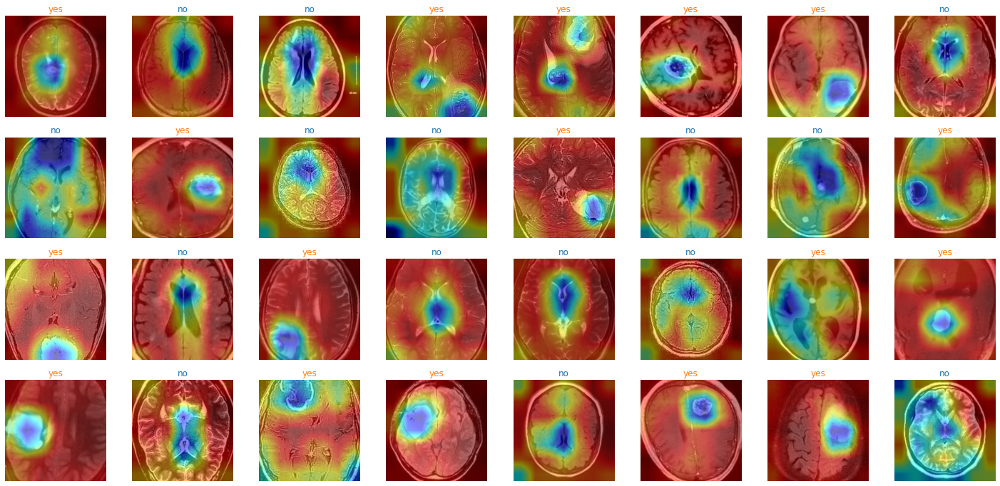

In [25]:
CAM(vgg16_imagenet, vgg16_imagenet.conv_layers[-1])